# RHRNet for Audio Denoising. 

Познакомимся с задачей разделения шума и речи в одноканальном аудиосигнале.

 Работать будем с датасетами **TIMIT**: это датасет чистой речи, люди с разными диалектами американского английского читают предложения. Вторым датасетом будет датасет шумов **DEMAND**.

 Моделью денойзинга будет **[RHRNet](https://arxiv.org/ftp/arxiv/papers/1904/1904.07294.pdf)**. Общая архитектура модели напоминает **U-net**, где каждый блок представляет собой двунаправленную реккурентную сеть. Модель работает с маленькими участками аудиофайла длиной $1024$, что при частоте дискретизации $16$ kHz соответствует $16$ ms.

**Наш план**:

- Научиться работать с аудиоданными: добавлять шум к аудио с разными уровнями **SNR**
- Создать датасеты для обучения и тестирования. 
- Реализовать модель
- Реализоввать инфраструктурные функции для обучения модели
- Обучить модель
- Посмотреть результаты

Импорт необходимых библиотек :)

In [ ]:
import numpy as np
import itertools
import torch
import librosa
import math

from glob import glob
from matplotlib import pyplot as plt
from torch import nn
from torch import optim
from torch.nn.utils import clip_grad_norm_
from torch.autograd import Variable
from torch.nn import functional as F
from IPython import display as ipd
from torch.utils.data import DataLoader, Dataset

# 9.1 Посмотреть на данные

## Примеры DEMAND

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data_root = "/content/drive/My Drive/Classroom/ML3 (OZON MASTERS) Machine learning"
demand_paths = glob(f"{data_root}/DEMAND/*.wav")

In [ ]:
idxs = [0, 88, 191]

In [ ]:
for idx in idxs:
  ipd.display(ipd.Audio(demand_paths[idx]))

Для работы с аудио будем использовать библиотеку **librosa**. 

Посмотрим спектральные характеристики представленных шумов. 

In [ ]:
audios = []
for idx in idxs:
    x, sr = librosa.load(demand_paths[idx], sr=16000)
    print(sr)
    audios.append(x)

16000
16000
16000


Воспользуемся функцией **librosa.display.waveplot**, чтобы отрисовать амплитуды аудиозаписей на участке, соответствующем одной секунде.

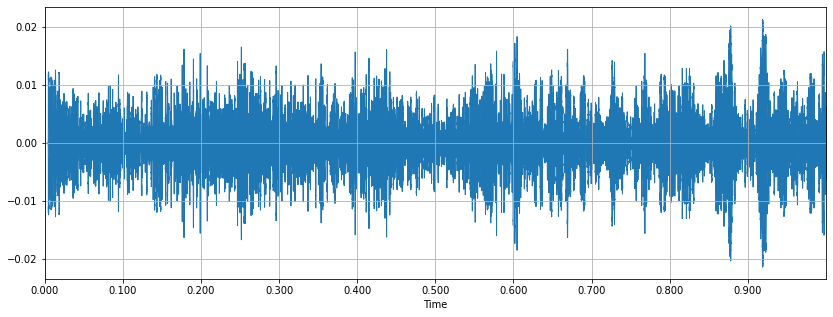

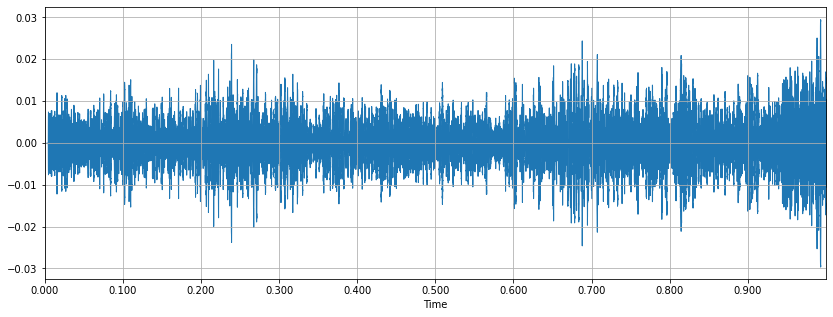

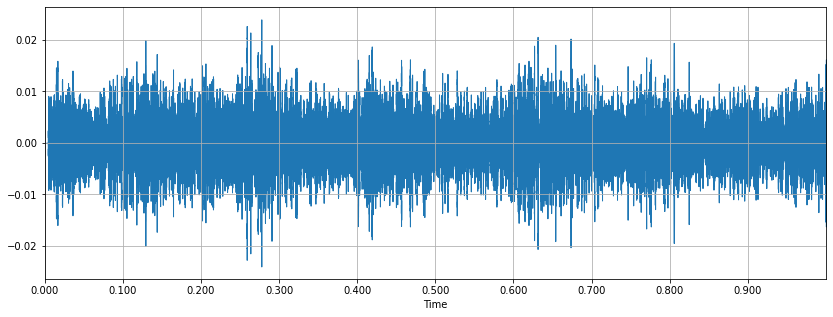

In [ ]:
import librosa.display
for x in audios:
    plt.figure(figsize=(14, 5))
    librosa.display.waveplot(x[:sr], sr)
    plt.grid()
    plt.show()

Воспользуемся функциями librosa.stft, librosa.amplitude_to_db, librosa.display.specshow, чтобы получить и отрисовать спектрограммы выбранных аудиозаписей.

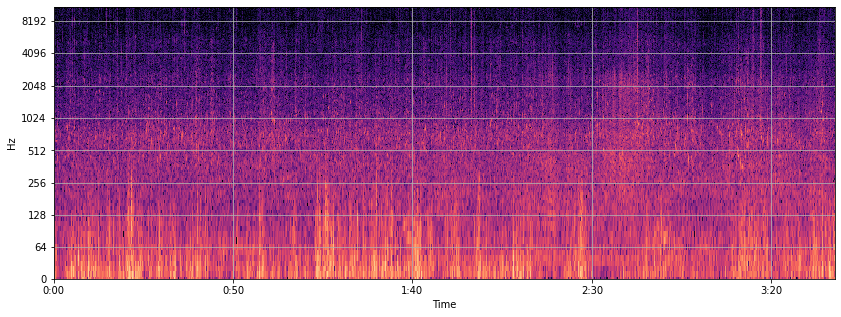

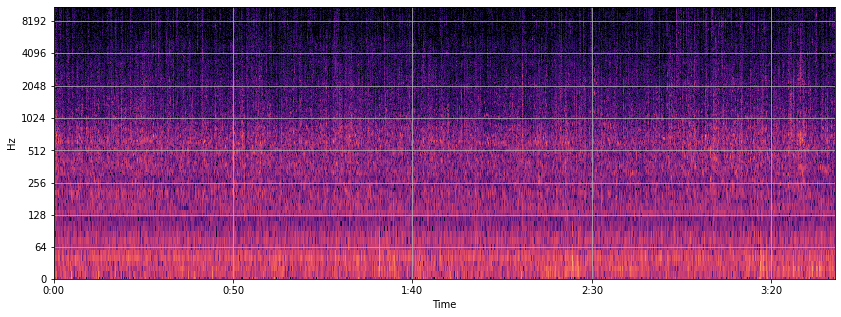

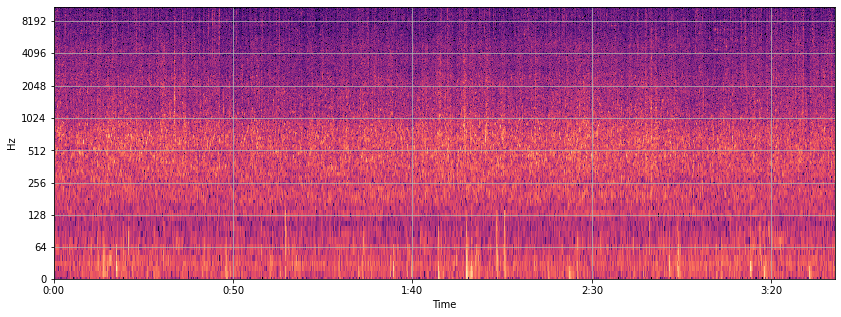

In [ ]:
for x in audios:
    plt.figure(figsize=(14, 5))
    mag_fr = np.abs(librosa.stft(x))
    img = librosa.display.specshow(librosa.amplitude_to_db(mag_fr), y_axis='log', x_axis='time')
    plt.grid()
    plt.show()

## Примеры TIMIT

Теперь посмотрим на образцы речи, которые будут использоваться в качестве элалонной чистой речи.

In [ ]:
data_root = "/content/drive/My Drive/Classroom/ML3 (OZON MASTERS) Machine learning"
timit_train_paths = glob(f"{data_root}/TIMIT/TRAIN/*/*/*.WAV")
timit_test_paths = glob(f"{data_root}/TIMIT/TEST/*/*/*.WAV")

In [ ]:
idxs = [0, 88, 191]

In [ ]:
audios = []
for idx in idxs:
    x, sr = librosa.load(timit_test_paths[idx], sr=16000)
    print(sr)
    audios.append(x)

16000
16000
16000


In [ ]:
for x in audios:
  ipd.display(ipd.Audio(x, rate=16000))

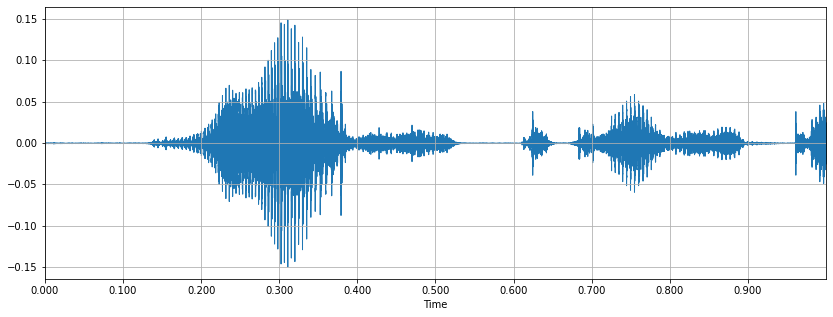

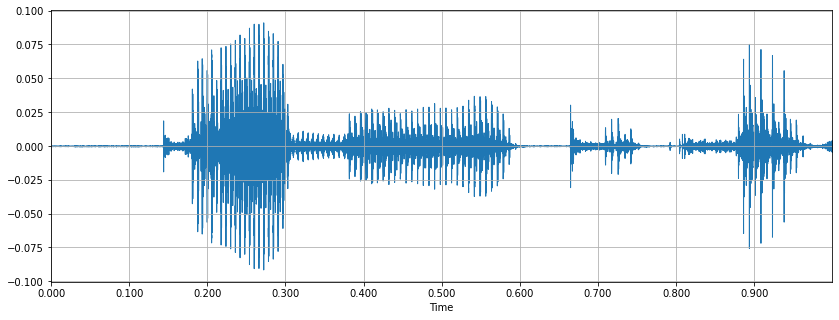

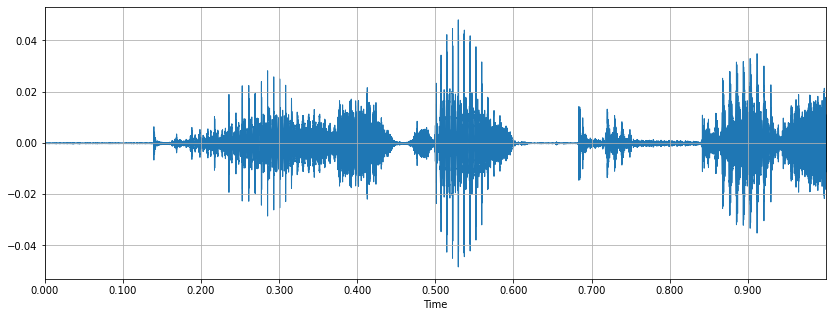

In [ ]:
import librosa.display
for x in audios:
    plt.figure(figsize=(14, 5))
    librosa.display.waveplot(x[:sr], sr)
    plt.grid()
    plt.show()

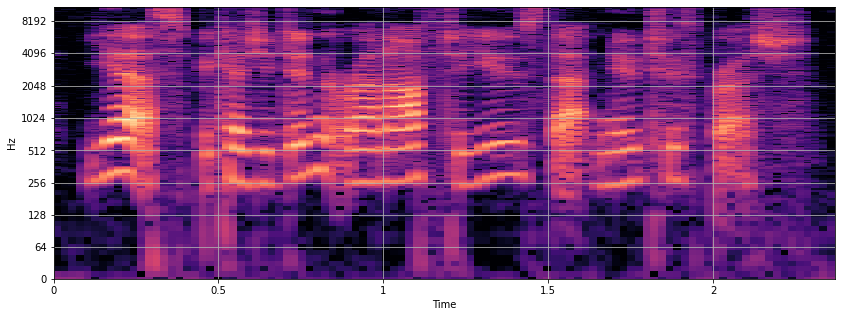

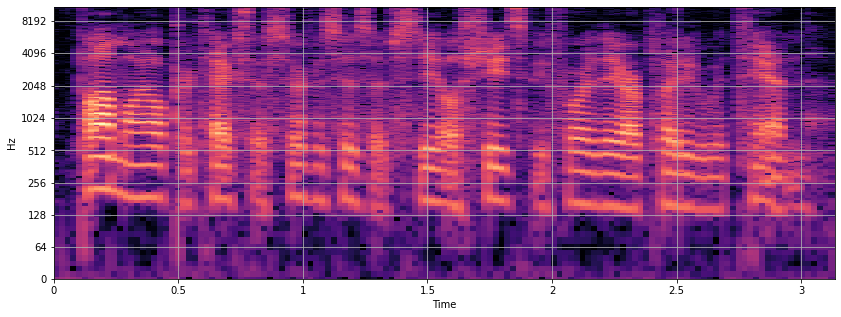

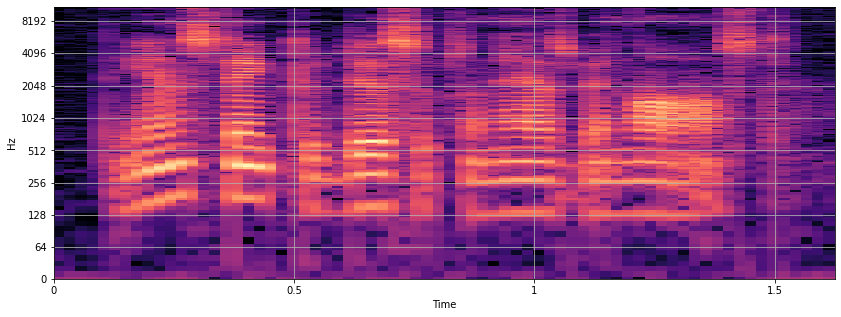

In [ ]:
for x in audios:
    plt.figure(figsize=(14, 5))
    mag_fr = np.abs(librosa.stft(x))
    librosa.display.specshow(librosa.amplitude_to_db(mag_fr), y_axis='log', x_axis='time')
    plt.grid()
    plt.show()

## Слияние шума и речи

Нам необходимо слить аудиозаписи и шумы с заданным **[SNR](https://en.wikipedia.org/wiki/Signal-to-noise_ratio)**.

In [ ]:
def add_noise(clean, noise, snr):
    clean_len = len(clean)
    noise_len = len(noise)
    if clean_len <= noise_len:
        noise = noise[:clean_len]
    else:
        rep = clean_len // noise_len
        noise = np.tile(noise, rep + 1)
        noise = noise[:clean_len]
    ratio = noise.dot(noise)/clean.dot(clean)
    noisy =  clean + noise/(10**(snr/20)*ratio)
    return noisy

In [ ]:
noise, sr = librosa.load(demand_paths[0], sr=16000)
clean, sr = librosa.load(timit_test_paths[0], sr=16000)
noisy_high = add_noise(clean, noise, 15)
noisy_low = add_noise(clean, noise, -5)

Отрисуем спектрограммы **clean, noisy_high, noisy_low.**

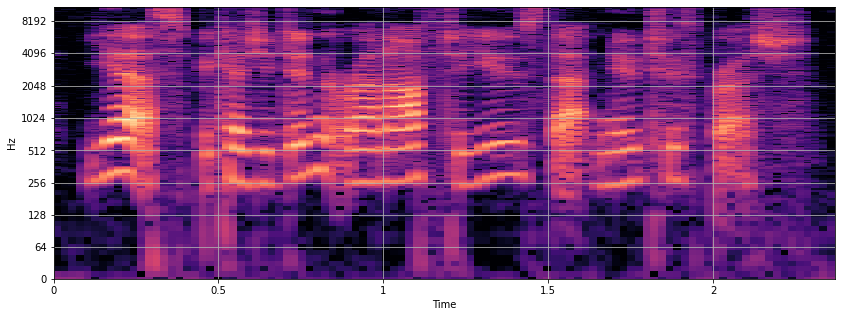

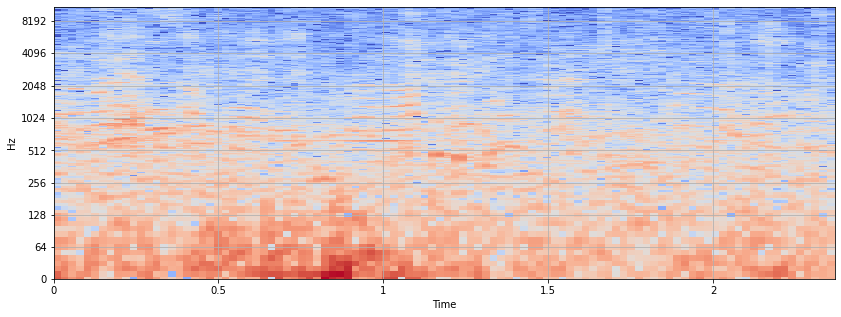

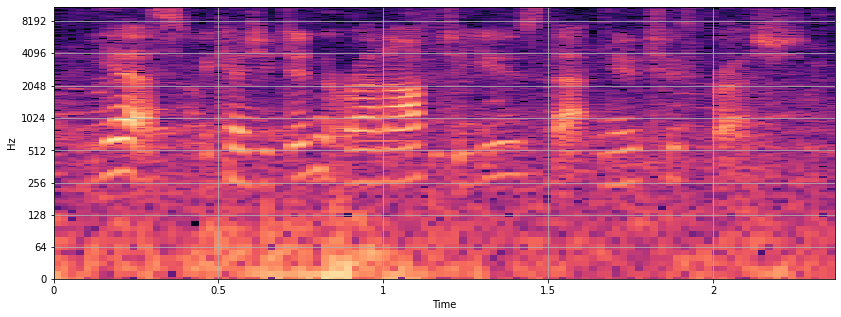

In [ ]:
for x in [clean, noisy_low, noisy_high]:
    plt.figure(figsize=(14, 5))
    mag_fr = np.abs(librosa.stft(x))
    librosa.display.specshow(librosa.amplitude_to_db(mag_fr), y_axis='log', x_axis='time')
    plt.grid()
    plt.show()

In [ ]:
for x in [clean, noisy_low, noisy_high]:
  ipd.display(ipd.Audio(x, rate=16000))

Низким значениям SNR соответствуют спектрограммы, похожие на шум, в то время как для значений в диапазоне 15-20 изменения выглядят не так существенно. 

## 9.2 Pytorch Datasets
### Train Dataset
Будем генерировать датасеты на лету, при этом тут есть подводный камень. Так как сегменты очень маленькие, то считывать файл с шумом и речью для каждого такого сегмента бессмысленно, поэтому будем считывать по целой аудиозаписи и на каждой итерации генерировать несколько сегментов для обучения.

Но в такой ситуации, чтобы случайно не переполнить память, ограничим количество сегментов в одной аудиозаписи.

In [ ]:
def collate_segments(inputs):
    """
    Performs batch creation from list of source signals.

    Parameters
    ----------
    inputs : tuple of list of tensors
        Input 1d arrays.

    Returns
    -------
    Tuple with clear and noised audios.

    """

    output = list(zip(*inputs))
    noisy = output[0]
    clear = output[1]

    noisy = torch.cat(noisy)
    clear = torch.cat(clear)

    return noisy, clear


class FastSegmentDataset(Dataset):
    def __init__(self, clean_paths, noise_paths, segment_length=1024, 
                 max_num_segments=80, snr_range=(0, 10)):

        self.max_num_segments = max_num_segments
        self.segment_length = segment_length
        self.noise_paths = noise_paths
        self.clean_paths = clean_paths
        self.snr_range = snr_range

    def __len__(self):
        return len(self.clean_paths)

    def __getitem__(self, item):
        rand_item = np.random.randint(0, len(self.noise_paths))
        rand_snr = np.random.randint(self.snr_range[0], self.snr_range[1])
        clean = librosa.load(self.clean_paths[item], sr=16000)[0]
        noise = librosa.load(self.noise_paths[rand_item], sr=16000)[0]
        noisy = add_noise(clean, noise, rand_snr)
        clean_len = len(clean)
        num_segments = clean_len // self.segment_length
        if num_segments > self.max_num_segments: num_segments = self.max_num_segments
        resize_noisy = np.resize(noisy, (num_segments, self.segment_length))
        resize_clean = np.resize(clean, (num_segments, self.segment_length))
        return torch.Tensor(resize_noisy), torch.Tensor(resize_clean)

In [ ]:
train_dataset = FastSegmentDataset(timit_train_paths, demand_paths)
train_dataloader = DataLoader(train_dataset, collate_fn=collate_segments, batch_size=3)

In [ ]:
noisy, clean = train_dataset[0]
noisy.shape, clean.shape

(torch.Size([45, 1024]), torch.Size([45, 1024]))

In [ ]:
noisy, clean = next(iter(train_dataloader))
noisy.shape, clean.shape

(torch.Size([102, 1024]), torch.Size([102, 1024]))

### Test Dataset

Для тестирования хотим использовать датасет, которые выдает целые аудиозаписи, так как интересует улучшение качества на полных записях, а не очень маленьких фрагментах. 

In [ ]:
class AudioDataset(Dataset):

    def __init__(self, clean_paths, noise_paths, snr_range=(0, 10)):
        self.noise_paths = noise_paths
        self.clean_paths = clean_paths
        self.snr_range = snr_range

    def __len__(self):
        return len(self.clean_paths)

    def __getitem__(self, item):
        rand_item = np.random.randint(0, len(self.noise_paths))
        rand_snr = np.random.randint(self.snr_range[0], self.snr_range[1])
        clean = librosa.load(self.clean_paths[item], sr=16000)[0]
        noise = librosa.load(self.noise_paths[rand_item], sr=16000)[0]
        noisy = add_noise(clean, noise, rand_snr)
        return torch.Tensor(noisy), torch.Tensor(clean)

In [ ]:
test_dataset = AudioDataset(timit_test_paths, demand_paths)
noisy, clean = test_dataset[0]
noisy.shape, clean.shape

(torch.Size([52122]), torch.Size([52122]))

## 9.3 Model RHRNet

Теперь реализуем модель. 

У модели должен быть реализован метод **infer**, который получает предсказания для одной полной аудиозаписи. При этом стоит ограничить количество подаваемых в батч сегментов, так как может переполняться память.

В рамках основной части реализуем метод, который запускает модель на последовательных кусочках без пересечения. 

![](https://drive.google.com/uc?export=view&id=19jA0QUmhmcOImxX1BDhk9b5Q66Dbl4Jt)

Ниже приведена функция, которая разбивает входной массив на сегменты с заданным шагом и длиной и склеивает результаты после преобразования.

Класс Transform может быть полезен при реализации метода **infer**.

In [ ]:
from torch.nn.functional import pad

class Pad1D:
    def __init__(self, before, after):
        self.before = before
        self.after = after

    def pad(self, x):
        return pad(x, (self.before, self.after), mode="constant", value=0.0)

    def unpad(self, x):
        if self.after > 0:
            return x[self.before:-self.after]
        else:
            return x[self.before:]


class Transform:
    def __init__(self, stride, segment_length, input_shape):

        self.segment_length = segment_length
        self.stride = stride

        stride_pad = stride * math.ceil(input_shape[-1] / self.stride) - input_shape[-1]
        self.pad_input = Pad1D(0, stride_pad)

        self.overlap_margin = segment_length - stride
        self.pad_window = Pad1D(self.overlap_margin, self.overlap_margin)

        stride = (1, stride)
        unfold_kernel = (1, segment_length)
        fold_kernel = (1, segment_length)

        final_size = (1, input_shape[-1] + stride_pad + 2 * self.overlap_margin)
        self.unfold = nn.Unfold(stride=stride, kernel_size=unfold_kernel)
        self.fold = nn.Fold(output_size=final_size, kernel_size=fold_kernel, stride=stride)
        self.shape = input_shape

    def process(self, x):
        x = x.view(-1)
        x = self.pad_input.pad(x)
        x = self.pad_window.pad(x)
        x = x.view(1, 1, 1, -1)
        x = self.unfold(x).permute(2, 0, 1)
        return x

    def unprocess(self, x):
        x = x.permute(1, 2, 0)
        x = self.fold(x)[0, 0, 0]
        if self.overlap_margin > 0:
            x = x[self.overlap_margin:-self.overlap_margin]
        x = self.pad_input.unpad(x)
        x = x.view(self.shape)
        return x

In [ ]:
x = torch.ones(1000)
transform = Transform(64, 64, x.shape)
print(transform.process(x).shape)
assert (transform.unprocess(transform.process(x)) == x).min()

torch.Size([16, 1, 64])


In [ ]:
class RHRNet(nn.Module):
    """
    RHR-Net: A Residual Hourglass Recurrent Neural Network for Speech Enhancement.

    Parameters
    ----------
    time_sizes : tuple of int,  optional (default=(1024, 512, 256, 128, 256, 512, 1024))
        Time dimension of the rnn layers.
    num_hidden : tuple of int, optional (default=(1, 64, 128, 256, 128, 64, 1))
        Number of hidden units in the rnn layers.
    num_input : tuple of int, optional (default=(1, 4, 256, 512, 256, 128, 64))
        Input sizes for the rnn layers.
    residuals : tuple of int, optional (default=(0, 1, 1, 0, -1, -1, 0))
        Contains values {-1, 0, 1}: 1 if a residual connection starts in the layer,
        -1 if a residual connection ends in the layer, 0 else.
    """

    def __init__(self, time_sizes=(1024, 512, 256, 128, 256, 512, 1024),
                 num_hidden=(1, 64, 128, 256, 128, 64, 1),
                 num_input=(1, 4, 256, 512, 256, 128, 64),
                 residuals=(0, 1, 1, 0, -1, -1, 0)
                 ):
        super(RHRNet, self).__init__()
        self.time_sizes = time_sizes
        self.num_hidden = num_hidden
        self.num_input = num_input
        self.residuals = residuals
        self.gru_1 = nn.GRU(input_size=self.num_input[0], hidden_size=self.num_hidden[0],
                            batch_first=True, bidirectional=True)
        self.gru_2 = nn.GRU(input_size=self.num_input[1], hidden_size=self.num_hidden[1],
                            batch_first=True, bidirectional=True)
        self.gru_3 = nn.GRU(input_size=self.num_input[2], hidden_size=self.num_hidden[2],
                            batch_first=True, bidirectional=True)
        self.gru_4 = nn.GRU(input_size=self.num_input[3], hidden_size=self.num_hidden[3],
                            batch_first=True, bidirectional=True)
        self.gru_5 = nn.GRU(input_size=self.num_input[4], hidden_size=self.num_hidden[4],
                            batch_first=True, bidirectional=True)
        self.gru_6 = nn.GRU(input_size=self.num_input[5], hidden_size=self.num_hidden[5],
                            batch_first=True, bidirectional=True)
        self.gru_7 = nn.GRU(input_size=self.num_input[6], hidden_size=self.num_hidden[6],
                            batch_first=True, bidirectional=False)
        self.skip = nn.Identity()
        self.prelu = nn.PReLU()

    def forward(self, x):
        connections = []
        x = x.reshape(-1, self.time_sizes[0], self.num_input[0])
        
        x, h_n = self.gru_1(x)
        if self.residuals[0] > 0: connections.append(x)
        
        x = x.reshape(-1, self.time_sizes[1], self.num_input[1])
        
        x, h_n = self.gru_2(x)
        if self.residuals[1] > 0: connections.append(x)
        
        x = x.reshape(-1, self.time_sizes[2], self.num_input[2])
        
        x, h_n = self.gru_3(x)
        if self.residuals[2] > 0: connections.append(x)
        
        x = x.reshape(-1, self.time_sizes[3], self.num_input[3])
        
        x, h_n = self.gru_4(x)
        
        x = x.reshape(-1, self.time_sizes[4], self.num_input[4])
        
        x, h_n = self.gru_5(x)
        if self.residuals[4] < 0: 
          x = self.prelu(x + self.skip(connections[-1]))
          connections = connections[:-1]
        
        x = x.reshape(-1, self.time_sizes[5], self.num_input[5])
        
        x, h_n = self.gru_6(x)
        if self.residuals[5] < 0: 
          x = self.prelu(x + self.skip(connections[-1]))
          connections = connections[:-1]
        
        x = x.reshape(-1, self.time_sizes[6], self.num_input[6])
        x, h_n = self.gru_7(x)
        if self.residuals[6] < 0: 
          x = self.prelu(x + self.skip(connections[-1]))
          connections = connections[:-1]
        x = x.reshape(-1, self.time_sizes[0])
        return x

    def infer(self, x, mode="separate", infer_batch_size=256):
        
        trans = Transform(self.time_sizes[0], self.time_sizes[0], x.shape)
        
        div_x = trans.process(x)

        res = self.forward(div_x)

        output = trans.unprocess(res.reshape(-1, 1, self.time_sizes[0]))

        return output


In [ ]:
torch.cuda.is_available()

True

In [ ]:
noisy, clean = next(iter(train_dataloader))
noisy.shape, clean.shape

(torch.Size([102, 1024]), torch.Size([102, 1024]))

In [ ]:
device = "cuda"
noisy, clean = noisy.to(device), clean.to(device)

In [ ]:
model = RHRNet().to(device)
model(noisy).shape

torch.Size([102, 1024])

In [ ]:
noisy, clean = test_dataset[0]
noisy, clean = noisy.to(device), clean.to(device)
assert model.infer(noisy).shape == noisy.shape

## 9.4 Loss Function

Оригинальная статья использует **LogCosh** функцию потерь. Соответственно в работе также предлагается использовать данную функцию потерь. 

$$
 \mathcal{L}(X, \hat{X}) = \frac{1}{n} \sum \limits_{i=1}^{n} \log \cosh (\mathbf{x_i} - \mathbf{\hat{x}}_i)
$$

In [ ]:
class LogCoshLoss(nn.Module):
    """Log Cosh Loss."""

    def __init__(self):
        super().__init__()

    def forward(self, clean, denoised):

        loss = torch.mean(torch.log(torch.cosh(clean - denoised)))


        return loss

## 9.5 Обучение модели 

In [ ]:
from tqdm import tqdm

class EmptyContext:
    def __enter__(self):
        pass
    def __exit__(self, type, value, traceback):
        pass

def perform_epoch(model, loader, criterion, metric=None,
                optimizer=None, device=None, scheduler=None, 
                max_grad_norm=None):
    is_train = optimizer is not None
    model = model.to(device)
    if is_train:  
        model.train()
    else:
        model.eval()

    total_loss = 0
    total_acc = 0
    total_n = 0
    with EmptyContext() if is_train else torch.no_grad():
        for batch_train, batch_answers in tqdm(loader):
            batch_train = batch_train.to(device)
            batch_answers = batch_answers.to(device)          
            model_answers = model(batch_train)
            new_loss = criterion(model_answers, batch_answers)
            if is_train:
              optimizer.zero_grad()
              new_loss.backward()
              
              if max_grad_norm is not None:
                clip_grad_norm_(model.parameters(), max_grad_norm)
              optimizer.step() 
              if scheduler is not None:
                scheduler.step()

            one_batch_loss = float(criterion(model_answers, batch_answers))
            total_loss += one_batch_loss

            if metric is not None:
              one_batch_metric = metric(model_answers, batch_answers)
              total_metric += one_batch_metric
            total_n += 1 
    if metric is not None:
        return (total_loss / total_n, total_metric / total_n)
    else:
        return total_loss / total_n

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
max_grad_norm = 10.
lr = 0.01
decay_rate = 0.9
num_epoches = 1
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
model = RHRNet().to(device)
loss_function = LogCoshLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, decay_rate)

Модель обучается достаточно долго, поэтому ограничимся одной эпохой.

In [ ]:
for epoch in range(num_epoches):
    loss = perform_epoch(model, train_dataloader, loss_function, 
                         optimizer=optimizer, device=device, 
                         max_grad_norm=max_grad_norm)
    
    print(f"Epoch - {epoch} : loss {loss}")
    print(f"Current learning rate: {optimizer.param_groups[0]['lr']}")
    scheduler.step()

100%|██████████| 1540/1540 [1:27:25<00:00,  3.41s/it]

Epoch - 0 : loss 0.0014852560828066466
Current learning rate: 0.01


In [ ]:
state = {
        'epoch': epoch + 1,
        'state_dict': model.state_dict(),
        'optimizer' : optimizer.state_dict()
        }

torch.save(state, './my_checkpoint.pth')

In [ ]:
import os

In [ ]:
os.path.isfile('./my_checkpoint.pth')

True

In [ ]:
checkpoint = torch.load('./my_checkpoint.pth')
model_state_dict = checkpoint['state_dict']
model.load_state_dict(model_state_dict)

<All keys matched successfully>

## 9.6 Результаты

Отобразим спектры для нескольких примеров

In [ ]:
l = len(timit_test_paths)
items = np.random.randint(0, l, 3)
print(items)

[1336  271 1449]


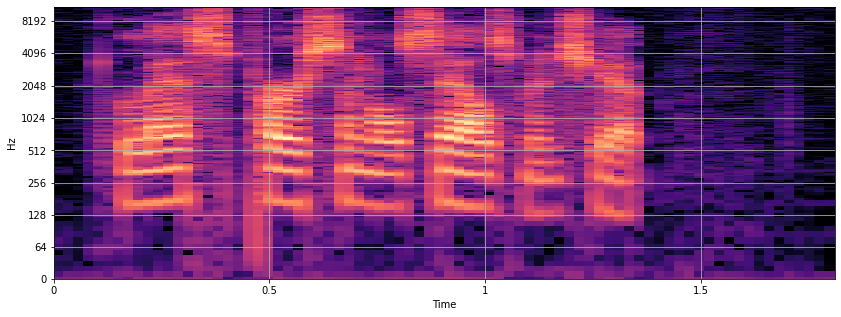

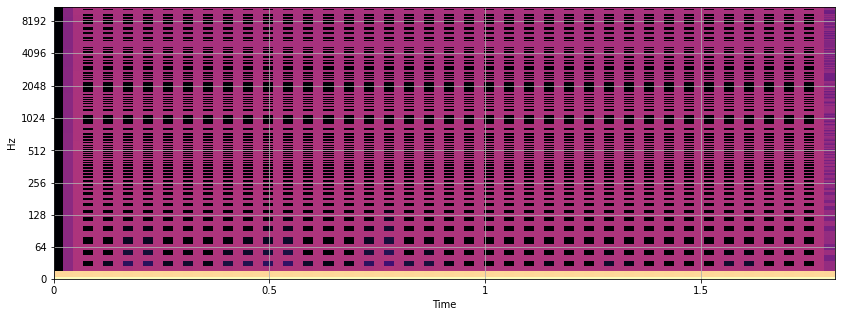

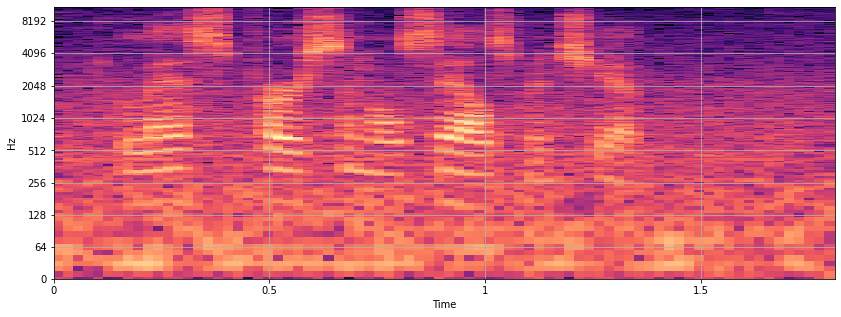

In [ ]:
noisy, clean = test_dataset[items[0]]
noisy = noisy.to(device)
clean = clean.cpu().numpy()
denoised = model.infer(noisy).cpu().detach().numpy()
noisy = noisy.cpu().numpy()
check = [clean, denoised, noisy]
for x in check:
    plt.figure(figsize=(14, 5))
    mag_fr = np.abs(librosa.stft(x))
    librosa.display.specshow(librosa.amplitude_to_db(mag_fr), y_axis='log', x_axis='time')
    plt.grid()
    plt.show()

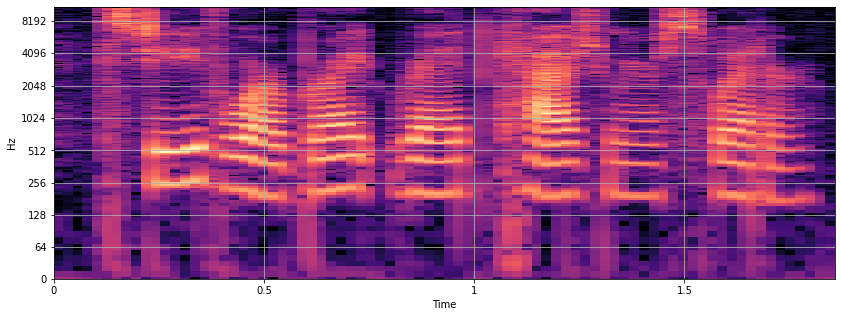

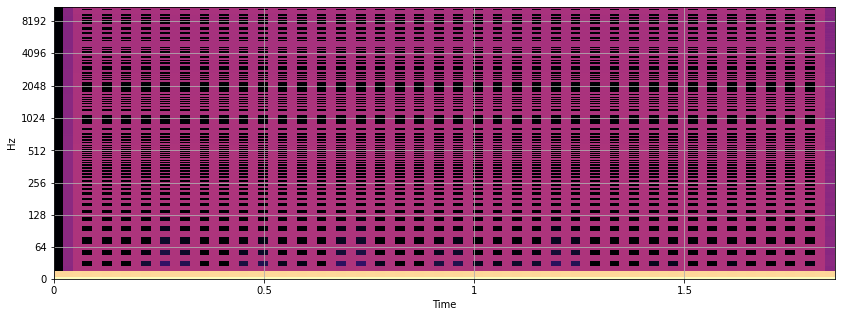

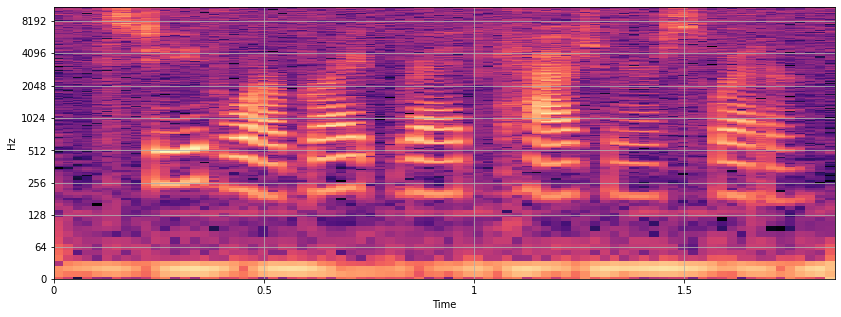

In [ ]:
noisy, clean = test_dataset[items[1]]
noisy = noisy.to(device)
clean = clean.cpu().numpy()
denoised = model.infer(noisy).cpu().detach().numpy()
noisy = noisy.cpu().numpy()
check = [clean, denoised, noisy]
for x in check:
    plt.figure(figsize=(14, 5))
    mag_fr = np.abs(librosa.stft(x))
    librosa.display.specshow(librosa.amplitude_to_db(mag_fr), y_axis='log', x_axis='time')
    plt.grid()
    plt.show()

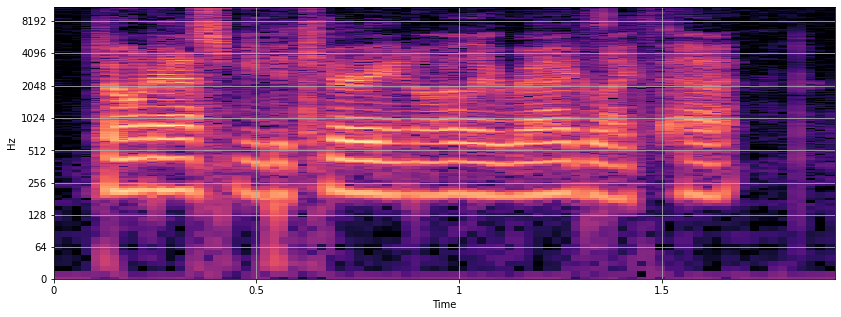

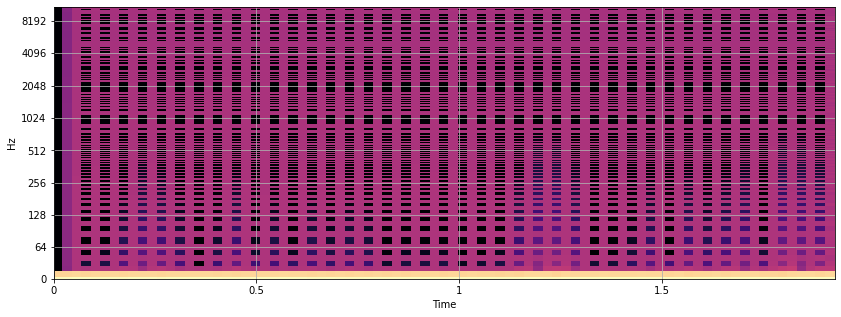

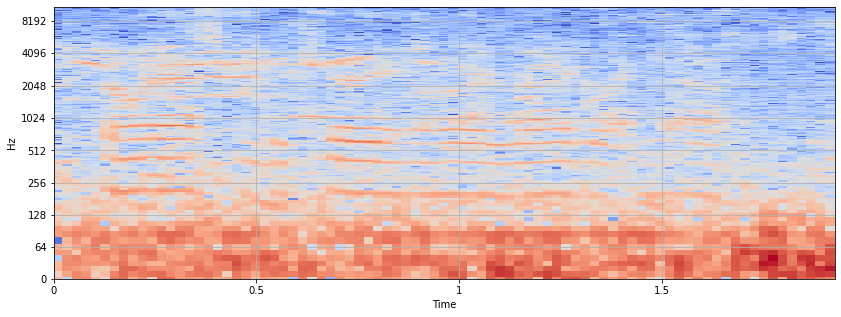

In [ ]:
noisy, clean = test_dataset[items[2]]
noisy = noisy.to(device)
clean = clean.cpu().numpy()
denoised = model.infer(noisy).cpu().detach().numpy()
noisy = noisy.cpu().numpy()
check = [clean, denoised, noisy]
for x in check:
    plt.figure(figsize=(14, 5))
    mag_fr = np.abs(librosa.stft(x))
    librosa.display.specshow(librosa.amplitude_to_db(mag_fr), y_axis='log', x_axis='time')
    plt.grid()
    plt.show()

In [ ]:
for x in check:
  ipd.display(ipd.Audio(x, rate=16000))

Модель выдает не то, что ожидалось:( С обучением возникают трудности, так как предсказание нулевого сигнала очень часто становится труднопроходимой точкой, также требуется больше времени на обучение.